# Wind turbine mapping data preparation and labeling

This notebook **automates the labeling of aerial photos** by leveraging the US wind turbine database. These labeled images will be utilized in a separate notebook to train an algorithm designed to recognize wind turbines in aerial or satellite images.

**Author:** _Francesco Paraggio_       
**Email:** francesco.paraggio _ at _ proton.me   
**License:** _AGPLv3_

In [1]:
import pandas as pd
import glob
import geopandas as gpd
from shapely import Polygon, wkt, contains_properly, box
import rasterio
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import rasterio.plot

## Data preparation

### US wind turbine database 

The dataset available at https://eerscmap.usgs.gov/uswtdb/ is a comprehensive resource that **provides detailed information on wind farms and individual turbines locations** across the United States. It includes precise coordinates for each turbine, as well as additional data pertaining to turbine geometry, models, and power specifications. This dataset is thoroughly described in the following publication:

[1] Hoen, B.D., Diffendorfer, J.E., Rand, J.T., Kramer, L.A., Garrity, C.P., and Hunt, H.E., 2018, United States Wind Turbine Database v5.1 (July 29, 2022): U.S. Geological Survey, American Clean Power Association, and Lawrence Berkeley National Laboratory data release, available at https://doi.org/10.5066/F7TX3DN0.

In [2]:
wtgs = catalog.load('turbines')

[11/07/23 09:52:54] INFO     Loading data from 'turbines' (CSVDataset)...                       ]8;id=429968;file:///home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=316564;file:///home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

In [3]:
wtgs.head()

,case_id,faa_ors,faa_asn,usgs_pr_id,eia_id,t_state,t_county,t_fips,p_name,p_year,...,t_rsa,t_ttlh,retrofit,retrofit_year,t_conf_atr,t_conf_loc,t_img_date,t_img_srce,xlong,ylat
0,3123233,40-097764,2021-WTW-7887-OE,NaN,NaN,OK,Ellis County,40045,25 Mile Creek,2022.0,...,17671.46,180.0,0,NaN,1,3,1/4/2023,Digital Globe,-99.775963,36.458096
1,3123609,40-097526,2021-WTW-7898-OE,NaN,NaN,OK,Ellis County,40045,25 Mile Creek,2022.0,...,17671.46,180.0,0,NaN,1,3,1/4/2023,Digital Globe,-99.751343,36.446674
2,3119868,40-097497,2021-WTW-7912-OE,NaN,NaN,OK,Ellis County,40045,25 Mile Creek,2022.0,...,17671.46,180.0,0,NaN,1,3,1/4/2023,Digital Globe,-99.735718,36.423359
3,3123202,40-097556,2021-WTW-7875-OE,NaN,NaN,OK,Ellis County,40045,25 Mile Creek,2022.0,...,17671.46,180.0,0,NaN,1,3,1/4/2023,Digital Globe,-99.782372,36.484463
4,3124077,40-097543,2021-WTW-7885-OE,NaN,NaN,OK,Ellis County,40045,25 Mile Creek,2022.0,...,17671.46,180.0,0,NaN,1,3,1/4/2023,Digital Globe,-99.782089,36.473541


In [4]:
len(wtgs)

72731

In [5]:
wtgs.columns


Index(['case_id', 'faa_ors', 'faa_asn', 'usgs_pr_id', 'eia_id', 't_state',
       't_county', 't_fips', 'p_name', 'p_year', 'p_tnum', 'p_cap', 't_manu',
       't_model', 't_cap', 't_hh', 't_rd', 't_rsa', 't_ttlh', 'retrofit',
       'retrofit_year', 't_conf_atr', 't_conf_loc', 't_img_date', 't_img_srce',
       'xlong', 'ylat'],
      dtype='object')

For a comprehensive understanding of the dataset's column descriptions and attributes, you can refer to the API Documentation, which can be found at https://eerscmap.usgs.gov/uswtdb/api-doc/. To enhance the convenience of data analysis, the column types and their respective descriptions are provided below for reference.

| Column name | Value Type | Description |
| :-- | :-- | :-- |
| case_id 	| number (integer) 	| Unique stable identification number.|
| faa_ors 	| string 	| Unique identifier for cross-reference to the Federal Aviation Administration (FAA) digital obstacle files.|
| faa_asn 	| string 	|Unique identifier for cross-reference to the FAA obstruction evaluation airport airspace analysis dataset.|
| usgs_pr_id 	| number (integer) 	| Unique identifier for cross-reference to the 2014 USGS turbine dataset.|
| t_state 	| string 	| State where turbine is located.|
| t_county 	| string 	| County where turbine is located.|
| t_fips 	| string 	| State and county fips where turbine is located, based on spatial join of turbine points with US state and county.|
| p_name 	|string 	| Name of the wind power project that the turbine is a part of. Project names are typically provided by the developer; some names are identified via other internet resources, and others are created by the authors to differentiate them from previous projects. Values are that were unknown were assigned a name based on the county where the turbine is located.|
| p_year 	| number (integer) 	| Year that the turbine became operational and began providing power. Note this may differ from the year that construction began.|
| p_tnum 	| number (integer) 	| Number of turbines in the wind power project.|
| p_cap 	| number (float) 	| Cumulative capacity of all turbines in the wind power project in megawatts (MW).|
| t_manu 	| string 	| Turbine manufacturer - name of the original equipment manufacturer of the turbine.|
| t_model 	| string 	| Turbine model - manufacturer's model name of each turbine.|
| t_cap 	| number (integer) 	| Turbine rated capacity - stated output power at rated wind speed from manufacturer, ACP, and/or internet resources in kilowatts (kW).|
| t_hh 	| number (float) 	| Turbine hub height in meters (m).|
| t_rd 	| number (float) 	| Turbine rotor diameter in meters (m).|
| t_rsa 	| number (float) 	| Turbine rotor swept area in square meters (m2).|
| t_ttlh 	| number (float) 	| Turbine total height from ground to tip of a blade at its apex in meters (m).|
| retrofit 	| number (integer) 	| Indicator of whether the turbine has been partially retrofit after initial construction (e.g., rotor and/or nacelle replacement). 0 indicates no known retrofit. 1 indicates yes known retrofit.|
| retrofit_year 	| number (integer) 	| Year in which the turbine was partially retrofit.|
| t_conf_atr 	| number (integer) 	| Level of confidence in the turbine attributes. 1—No confidence: no attribute data beyond total height and year, 2—Partial confidence: incomplete information or substantial conflict between, 3—Full confidence: complete information, consistent across multiple data sources.|
| t_conf_loc 	| number (integer) 	| Level of confidence in turbine location. 1— No turbine shown in image; image has clouds; imagery older than turbine built date, 2— Partial confidence: image shows a developed pad with concrete base and/or turbine parts on the ground, 3— Full confidence: image shows an installed turbine.|
| t_img_date 	| number (integer) 	| Date of image used to visually verify turbine location. Note if source of image is NAIP, the month and day were set to 01/01.|
| t_img_srce 	| string 	| Source of image used to visually verify turbine location.|
| xlong 	| number (float) 	| Longitude of the turbine point, in decimal degrees.|
| ylat 	| number (float) 	| Latitude of the turbine point, in decimal degrees.|
| eia_id 	| number (integer) 	| Plant ID from Energy Information Administration (EIA).|

<img src="./images/turbine_attributes.jpg" style="margin:auto"/>
<p style='text-align: center;'>FIGURE 1 - Wind turbine geometry in the US wind turbine database <br>Photo by Tom Corser www.tomcorser.com, edited by Francesco Paraggio <a href="https://creativecommons.org/licenses/by-sa/3.0">CC BY-SA 3.0</a>, via Wikimedia Commons </p>

From the dataset, we opt to load only the pertinent columns and filter turbines with a __high degree of certainty in both their attributes and geographical location.__ More than 60k records are still available.

In [6]:
turbine_subset = wtgs[['case_id','t_rd','xlong','ylat','t_hh','t_ttlh', 't_cap', 't_manu','t_model', 't_conf_atr','t_conf_loc']]
turbine_subset = turbine_subset[(turbine_subset['t_conf_atr']==3) & (turbine_subset['t_conf_loc']==3)]
turbine_subset = turbine_subset.dropna()

In [7]:
len(turbine_subset)

60877

Subsequently, the **dataframe is enriched by incorporating turbine coordinates as geometry, transforming it into a GeoDataFrame**. This augmentation enables the execution of spatial analyses and queries, expanding the dataset's utility for geographic investigations.

In [8]:
turbinesdf = gpd.GeoDataFrame(
    turbine_subset, 
    geometry = gpd.points_from_xy(turbine_subset['xlong'], turbine_subset['ylat']), 
    crs = 'EPSG:4326'
)

### Aerial photos labeling

The images used to train our model are obtained from the __Power Plant Satellite Imagery Dataset__, which contains high-resolution (1m) aerial photos from the USDA National Agriculture Imagery Program (NAIP). These images are accessible via the Duke Energy Initiative at https://figshare.com/articles/dataset/Power_Plant_Satellite_Imagery_Dataset/5307364.

These images are equipped with important geographical information, allowing us to pinpoint their location and perform spatial analyses. In our process, __we query the spatialized US database to examine each image and identify if there is any turbine from the db. For each detected turbine, we create a label by generating a buffer zone around the turbine's coordinates. To train our model, we transform these buffer zones' geographical coordinates into pixel coordinates within the images.__

<img src="./images/label_area.png" style="margin:auto"/>
<p style='text-align: center;'>FIGURE 2 - label_naip_images example box<br> Photo from the Power Plant Satellite Imagery Dataset, edited by Francesco Paraggio </p>

Currently, we set the buffer size at 0.6 times the total height of the turbines. However, we acknowledge that for a more precise assessment, it's important to consider additional factors, such as the tilt and height of the aerial photos. You can find more insights on this topic at https://gis.depaul.edu/shwang/teaching/geog258/lec7.htm.

In an ideal scenario, our assessment would encompass not only factors like hub height and total turbine height but also the perspective distortion caused by the height and angle of the viewing point. Unfortunately, the metadata in the image files does not provide this information. However, it may be available through the NAIP resources, as outlined in their documentation at https://www.fsa.usda.gov/Internet/FSA_File/naip_best_practice.pdf.

TODO. satellite data labeling and training

In [9]:
def square_poly(lat, lon, distance):
    """
    Generates a square-shaped bounding box around a specified point, given its geographical coordinates 
    (latitude and longitude) and a buffer radius in meters.

    This function first converts the input coordinates to the EPSG:3857 projection to create the buffer, 
    and then reverts the result back to EPSG:4326 for the output. The resulting polygon represents a square 
    with the specified distance as the side length and the center at the provided latitude and longitude.

    Parameters:
        lat (float): Center latitude in geographical coordinates (EPSG:4326).
        lon (float): Center longitude in geographical coordinates (EPSG:4326).
        distance (float): Buffer radius in meters to determine the side length of the square.

    Returns:
        geopandas.geoseries.GeoSeries: A GeoSeries containing the square-shaped polygon in geographical 
        coordinates (EPSG:4326).
    """
    gs = gpd.GeoSeries(wkt.loads(f'POINT ({lon} {lat})'))
    gdf = gpd.GeoDataFrame(geometry=gs)
    gdf.crs='EPSG:4326'
    gdf = gdf.to_crs('EPSG:3857')
    # Buffer the points using a square cap style
    # Note cap_style: round = 1, flat = 2, square = 3
    res = gdf.buffer(
        distance=distance,
        cap_style=3,
    )
    return res.to_crs('EPSG:4326').iloc[0]

In [10]:
def label_naip_images(files, turbinedf, distance_ratio):
    """
    Generate labels for geotiff images based on the provided enhanced US wind turbine database.
    
    This function associates geotiff images with wind turbines from the given database, calculates 
    label boxes for the turbines, and enriches the database with label-related information.

    Parameters:
        files (list): List of geotiff image file paths to be labeled.
        turbinedf (geopandas.GeoDataFrame): Enhanced US wind turbine database as a GeoDataFrame.
        distance_ratio (float): A multiplier for calculating the buffer distance for label boxes 
                                (buffer = distance_ratio * t_ttlh).

    Returns:
        geopandas.GeoDataFrame: The enhanced turbine database with added label columns.

    The function performs the following steps:
    1. Copy the input database to avoid modifying the original data.
    2. For each geotiff image file in the list:
       a. Open the geotiff raster and retrieve its metadata.
       b. Query the turbines contained within the image's bounding box.
       c. Associate the image file, raster width, and raster height with the turbines in the image.
       d. For each turbine in the image:
          i. Calculate the pixel coordinates of the turbine's center.
          ii. Create a label box around the turbine based on the buffer distance.
          iii. Ensure the label box falls within the raster bounds.
          iv. Store the label box and its pixel coordinates in the database.
    3. Remove turbines not contained within any images.
    4. Return the enriched turbine database with added label columns.

    Example usage is provided in the "Data preparation and labeling" notebook.
    """
    gdf = turbinedf.copy()
    for file in tqdm(files): # for each file
        raster = rasterio.open(file) # opening the raster file
        meta = raster.meta # loading raster file metadata
        turbines_in_image = gdf.sindex.query(box(*raster.bounds), predicate="contains") # query which turbines are contianed in the raster
        gdf.loc[gdf.iloc[turbines_in_image].index, 'image'] = file # associating the file to the turbines  
        gdf.loc[gdf.iloc[turbines_in_image].index, 'width'] = raster.width # associating rasted width to the turbines
        gdf.loc[gdf.iloc[turbines_in_image].index, 'height'] = raster.height # associating rasted heigth to the turbines
        for t in turbines_in_image: # for each turbine in the image
            turbine_row = gdf.iloc[t].name
            turbine = gdf.loc[turbine_row]
            turbine_pixel_coordinates = rasterio.transform.rowcol(meta['transform'],  # fetch pixel coordinates of the turbine
                                                                  xs=turbine['xlong'], 
                                                                  ys=turbine['ylat'])
            gdf.loc[turbine_row,'cx'] = turbine_pixel_coordinates[1] # associating turbine center pixel coordinates to the turbine
            gdf.loc[turbine_row,'cy'] = turbine_pixel_coordinates[0]
            turbine_box = square_poly(turbine['ylat'], # drawing the label box
                                      turbine['xlong'], 
                                      distance=distance_ratio*turbine['t_ttlh'])
            if contains_properly(box(*raster.bounds), turbine_box): # removing label boxes that falls outside the raster bounds (turbines on the edge of the file)
                gdf.loc[turbine_row,'box'] = turbine_box
                minx_miny_coordinates = rasterio.transform.rowcol(meta['transform'], # label boxes pixel coordinates
                                                                  xs=turbine_box.bounds[0], 
                                                                  ys=turbine_box.bounds[1])
                
                maxx_maxy_coordinates = rasterio.transform.rowcol(meta['transform'],
                                                                  xs=turbine_box.bounds[2], 
                                                                  ys=turbine_box.bounds[3])
                xs = [minx_miny_coordinates[1], maxx_maxy_coordinates[1]] # in px x are columns-> rowcol[1]
                ys = [minx_miny_coordinates[0],maxx_maxy_coordinates[0]] # in px y are rows-> rowcol[0]
                gdf.loc[turbine_row,'minx'] = min(xs) # associating label box pixel coordinates to the turbine
                gdf.loc[turbine_row,'miny'] = min(ys)
                gdf.loc[turbine_row,'maxx'] = max(xs)
                gdf.loc[turbine_row,'maxy'] = max(ys)
    gdf = gdf.dropna() # removing turbines that are not contained in the images
    return gdf

In [11]:
image_files = catalog.load('naip_images')

[11/07/23 09:53:10] INFO     Loading data from 'naip_images' (ImageFolderDataset)...            ]8;id=328004;file:///home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=525039;file:///home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/kedro/io/data_catalog.py#502\502]8;;\

In [12]:
gdf = label_naip_images(image_files, turbinesdf, 0.6)

  0%|          | 0/457 [00:00<?, ?it/s]

In [13]:
gdf.head()

,case_id,t_rd,xlong,ylat,t_hh,t_ttlh,t_cap,t_manu,t_model,t_conf_atr,...,image,width,height,cx,cy,box,minx,miny,maxx,maxy
63,3049503,125.0,-93.523651,42.006813,87.5,150.0,3000.0,Nordex,AW125/3000,3,...,/home/persepolis/prj/fp/un-wind/wind-turbine-d...,1114.0,1114.0,552.0,571.0,"POLYGON ((-93.5228425162443 42.00741375335109,...",462.0,505.0,642.0,638.0
64,3049500,125.0,-93.515892,42.016373,87.5,150.0,3000.0,Nordex,AW125/3000,3,...,/home/persepolis/prj/fp/un-wind/wind-turbine-d...,1115.0,1114.0,303.0,867.0,POLYGON ((-93.51508351624429 42.01697366306611...,213.0,800.0,393.0,934.0
65,3049504,125.0,-92.672089,41.742046,87.5,150.0,3000.0,Nordex,AW125/3000,3,...,/home/persepolis/prj/fp/un-wind/wind-turbine-d...,1115.0,1114.0,572.0,545.0,"POLYGON ((-92.6712805162443 41.74264924716535,...",482.0,478.0,662.0,612.0
66,3057059,125.0,-93.623009,41.881470,87.5,150.0,3000.0,Nordex,AW125/3000,3,...,/home/persepolis/prj/fp/un-wind/wind-turbine-d...,1114.0,1115.0,562.0,505.0,POLYGON ((-93.62220051624428 41.88207193554672...,472.0,438.0,652.0,572.0
70,3053390,125.0,-93.700424,41.977608,87.5,150.0,3000.0,Nordex,AW125/3000,3,...,/home/persepolis/prj/fp/un-wind/wind-turbine-d...,1114.0,1115.0,571.0,601.0,POLYGON ((-93.69961551624428 41.97820902906054...,481.0,534.0,661.0,667.0


## Label visual ispection

In [14]:
def plot_image_with_turbine_boxes(filepath, gdf, print_turbine_number=False):
    """
    Plots an image with bounding boxes around turbines, if any are found in the specified GeoDataFrame.

    Parameters:
        filepath (str): The file path to the image to be plotted.
        gdf (geopandas.GeoDataFrame): A GeoDataFrame containing turbine information, including geometries and image references.
        print_turbine_number (bool, optional): If True, print the case_id of each turbine found. Default is False.

    Returns:
        None

    This function takes a file path to an image and a GeoDataFrame containing turbine information. 
    It plots the image and overlays bounding boxes around turbines if they are found within the GeoDataFrame. 
    If print_turbine_number is set to True, it also prints the case_id of each turbine found in the image. If no turbines are found, 
    it prints a message indicating that no turbines were detected in the image.
    """
    filename = filepath.split('/')[-1]
    turbines =  gdf[gdf['image'].str.contains(filename, na=False)]
    if len(turbines) > 0:
        raster = rasterio.open(filepath)
        fig, ax = plt.subplots(figsize=(15, 15))
        
        rasterio.plot.show(raster, ax=ax)
        
        for geom in turbines['geometry']:
            #print(geom)
            gpd.GeoSeries(geom).plot(ax=ax, facecolor='none', edgecolor='red')
            #plt.plot(*geom.exterior.xy, color='red', linewidth=2)
        for geom in turbines['box']:
            #print(geom)
            gpd.GeoSeries(geom).plot(ax=ax, facecolor='none', edgecolor='red')
        plt.show()
        if print_turbine_number:
            for tname in turbines['case_id']:
                print(tname)
    else:
        print(f'No turbines found for the image {filepath}')

In [15]:
images_with_labels = gdf['image'].unique()

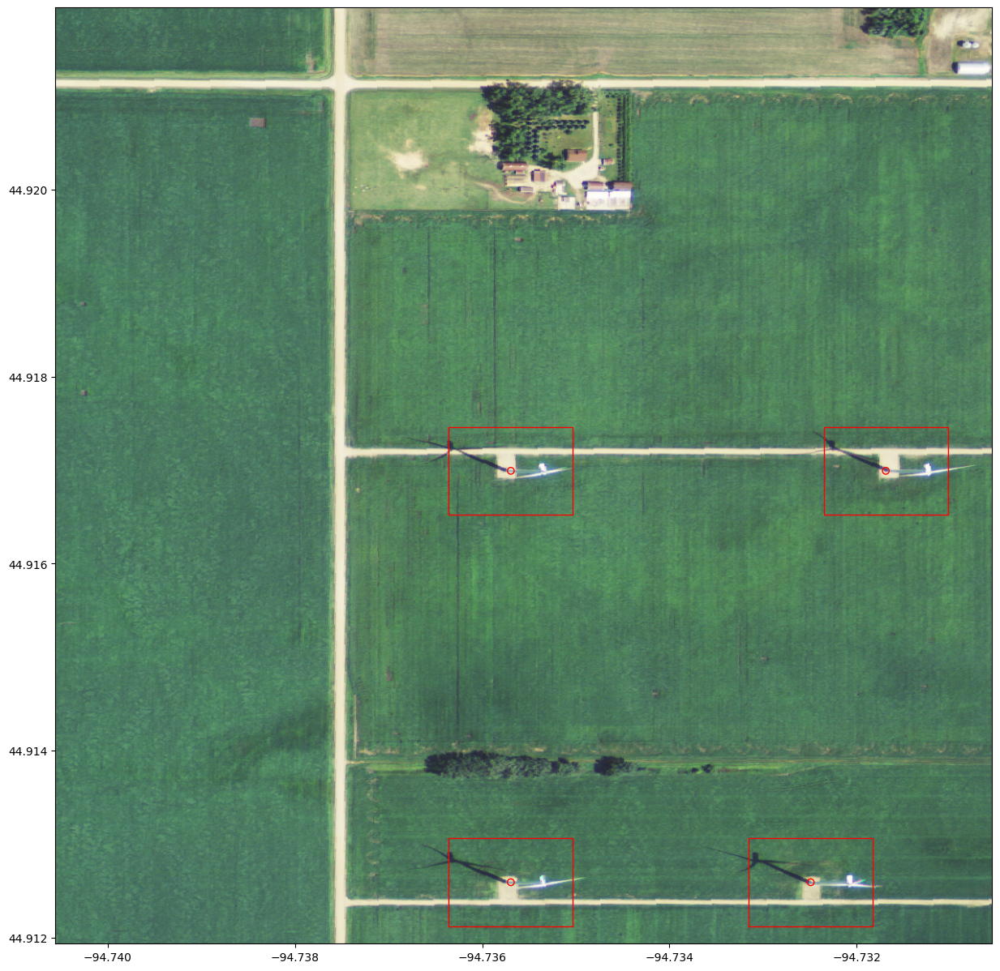

3034124
3034123
3034117
3046404


In [16]:
plot_image_with_turbine_boxes(images_with_labels[6], gdf, True)

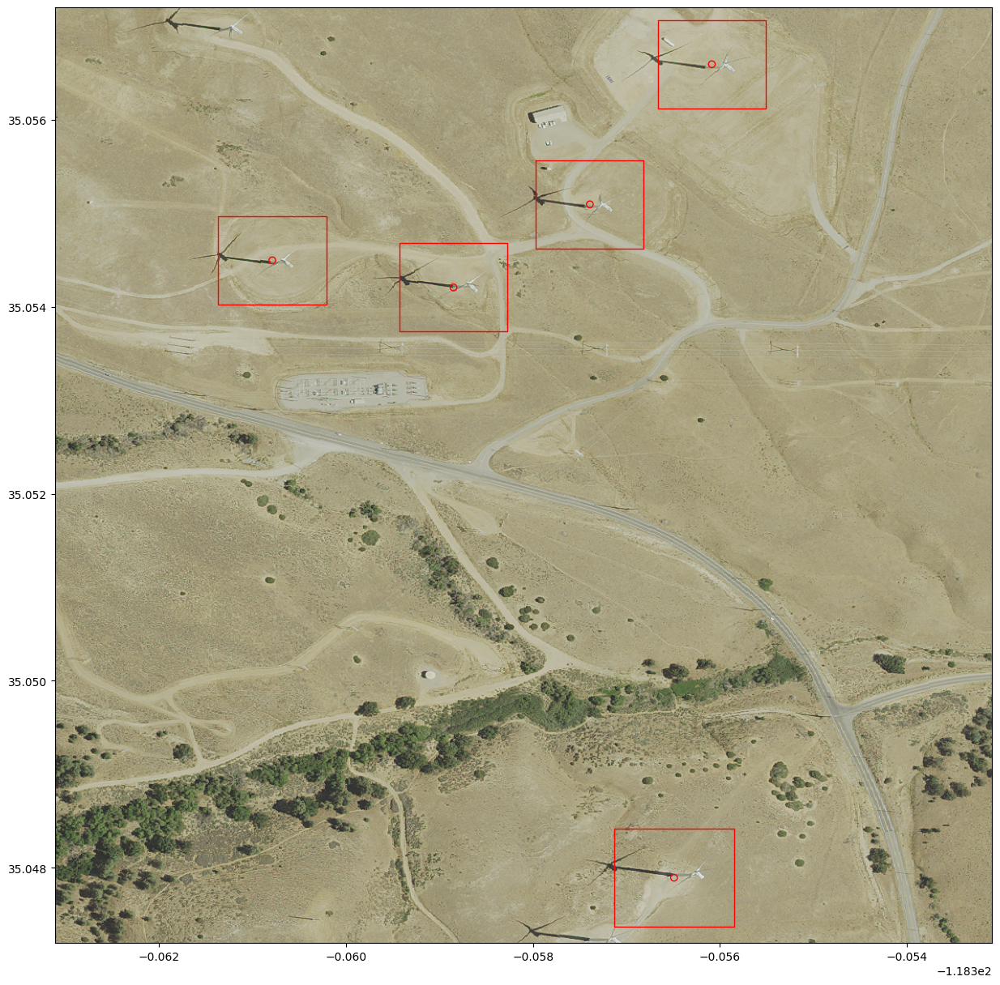

3048567
3084508
3036653
3037097
3037096


In [17]:
plot_image_with_turbine_boxes(images_with_labels[9], gdf, True)

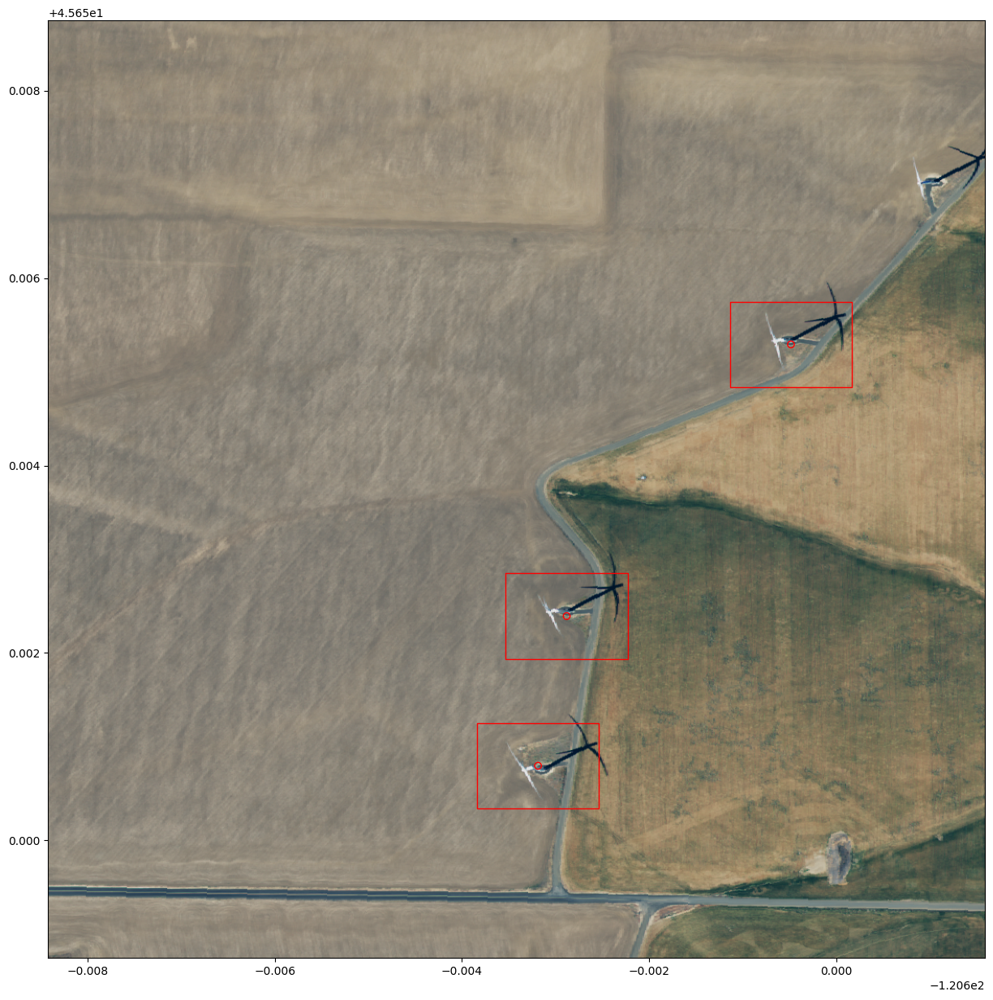

3023428
3023429
3023427


In [18]:
plot_image_with_turbine_boxes(images_with_labels[22], gdf, True)

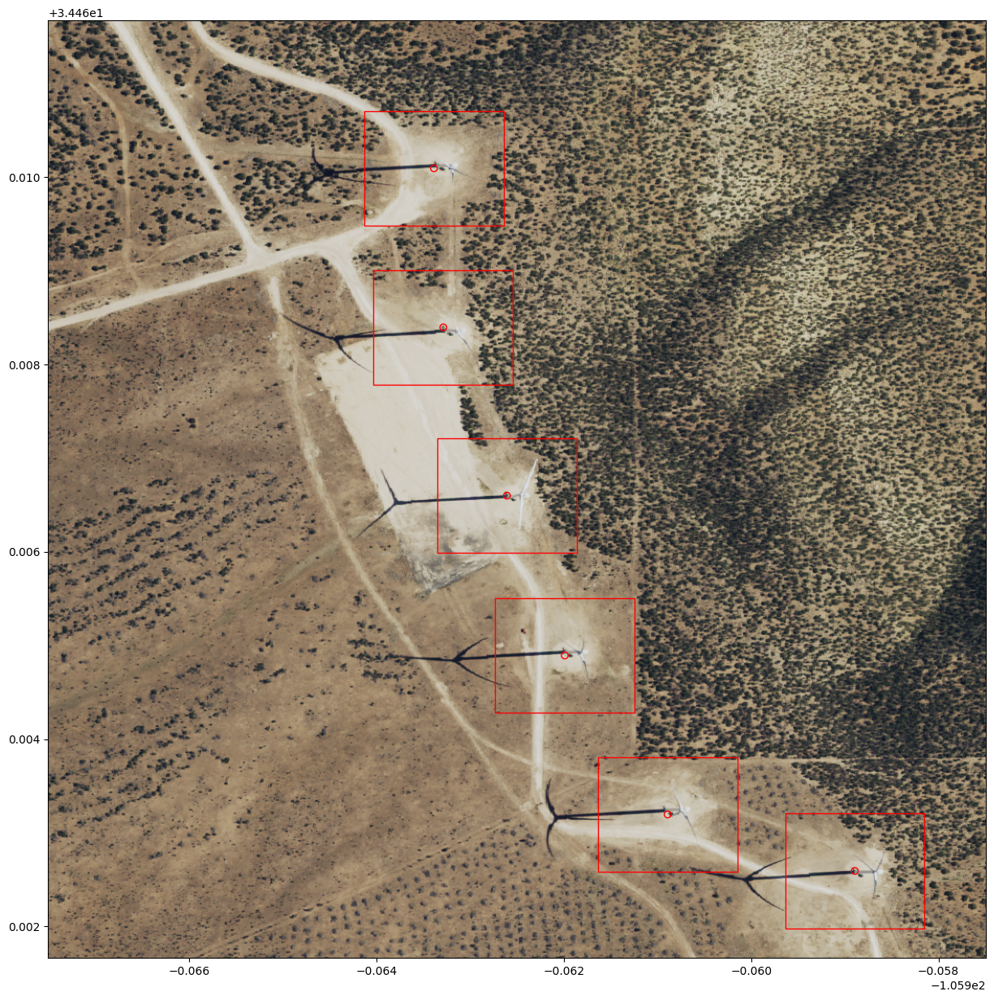

3104866
3104864
3104857
3104845
3104841
3098750


In [19]:
plot_image_with_turbine_boxes(images_with_labels[130], gdf, True)

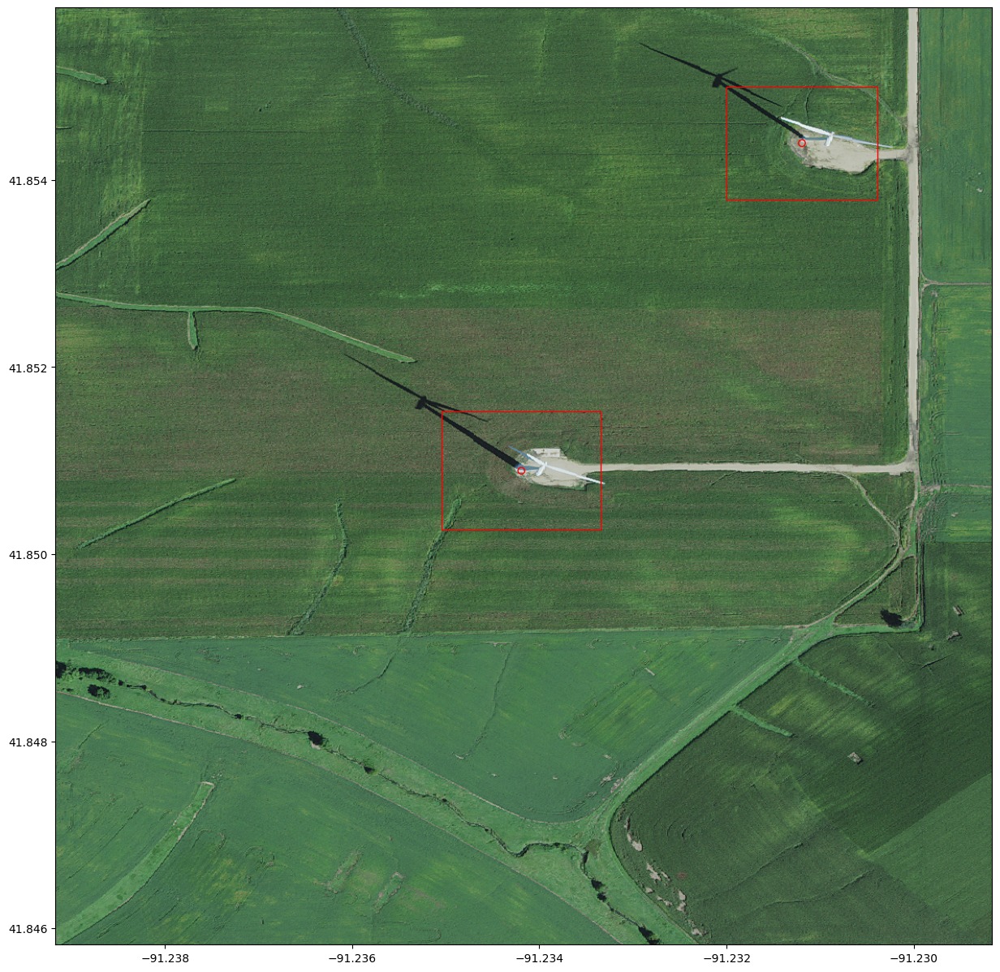

3053440
3039074


In [20]:
plot_image_with_turbine_boxes(images_with_labels[220], gdf, True)

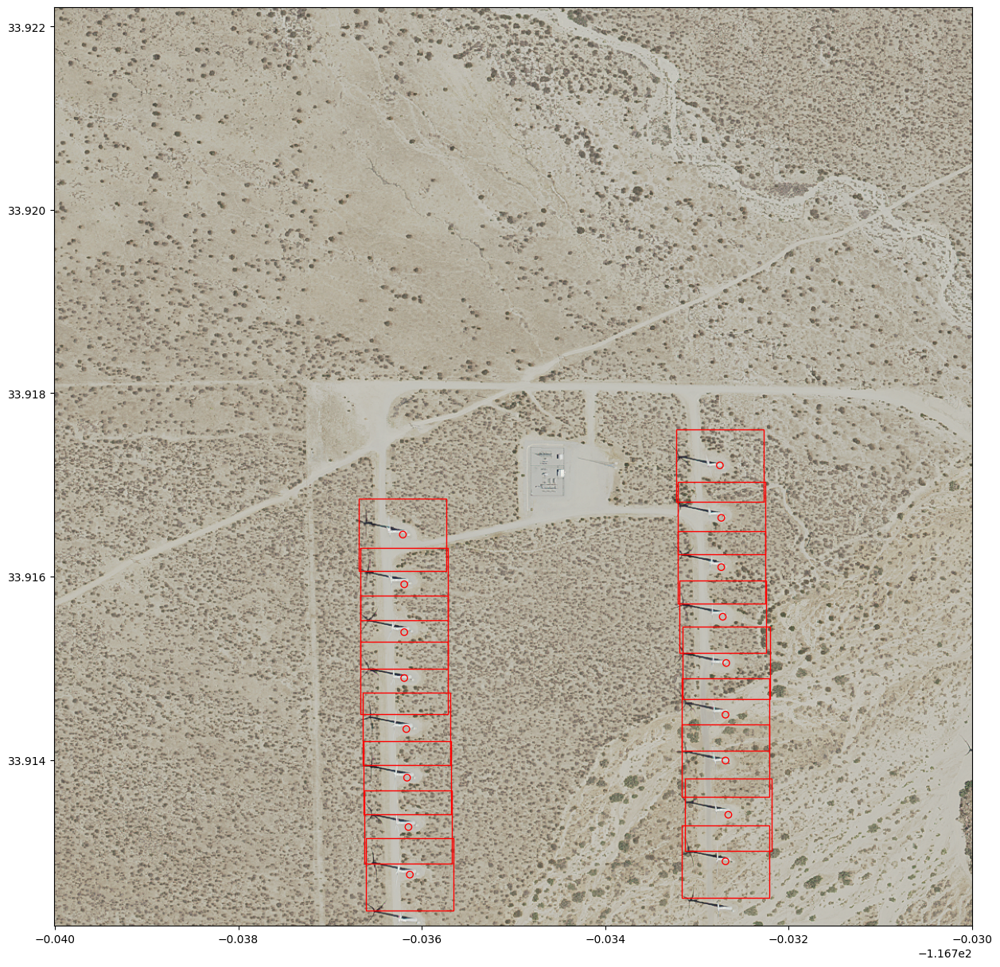

3007930
3072147
3072178
3007596
3011362
3072186
3072177
3072224
3072216
3072135
3072179
3072183
3072214
3072190
3005165
3004411
3011216


In [21]:
plot_image_with_turbine_boxes(images_with_labels[40], gdf, True)

In [22]:
case_with_overlap = 3072216

Labels that cover multiple turbines and exhibit overlap are less precise; thus, we will proceed to eliminate such overlapping labels in the upcoming steps.

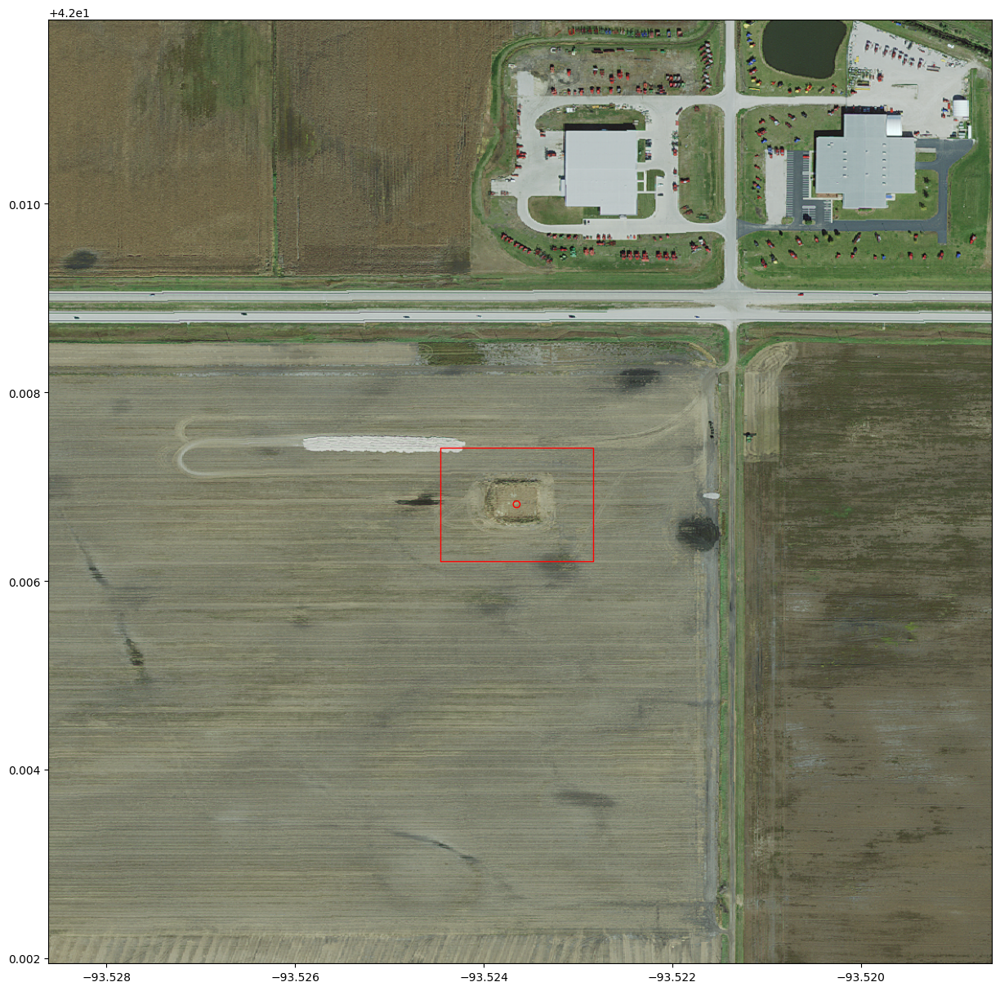

3049503


In [23]:
plot_image_with_turbine_boxes(images_with_labels[0], gdf, True)

In [24]:
case_without_turbine=3049503

In [25]:
gdf[gdf['case_id']==case_without_turbine].iloc[0]['t_conf_loc']

3

In certain instances, such as case number 3049503, even though 't_conf_loc' is set to 3, there is no turbine visible in the photo. __It is advisable to conduct a visual inspection of all the photos before initiating the training process.__

## Removal of overlapping labels

In [26]:
def label_overlapping_boxes(turbine_df):
    """
    Identify and label overlapping bounding boxes within a GeoDataFrame containing turbine data.

    This function takes a GeoDataFrame with turbine data, where each row represents a turbine 
    with a bounding box. It identifies overlapping bounding boxes and assigns a label to indicate 
    the presence of overlap. The following steps are performed by the code:

    1. Create a copy of the input GeoDataFrame to prevent modifying the original data.
    2. Convert the 'box' column into a GeoSeries to treat the boxes as geometries.
    3. Dissolve overlapping geometries into one large multipolygon.
    4. Split the multipolygon into individual non-overlapping parts.
    5. Set the coordinate reference system (CRS) for the resulting single parts to EPSG:4326.
    6. Calculate a 'cluster' column to assign a unique cluster/row number to each single part.
    7. Perform a spatial join to associate cluster numbers with the original GeoDataFrame.
    8. Merge the original GeoDataFrame with the counts of geometries per cluster.
    9. Remove the 'index_right' column created during the spatial join.
    10. Create an 'overlaps' column indicating whether a turbine's bounding box overlaps with others in the same cluster.

    Parameters:
        turbine_df (geopandas.GeoDataFrame): A GeoDataFrame containing turbine data with bounding boxes.

    Returns:
        geopandas.GeoDataFrame: The input GeoDataFrame enriched with an 'overlaps' column indicating box overlap.
    """
    gdf = turbine_df.copy()
    gdf['geometry'] = gpd.GeoSeries(gdf['box'])
    diss = gdf.dissolve() #Dissolve into one big multipolygon
    singleparts = gpd.GeoDataFrame(geometry=diss.apply(lambda x: [part for part in x.geometry.geoms], axis=1).explode(), crs=gdf.crs) #Multipart to singleparts
    singleparts.crs = "EPSG:4326"
    singleparts["cluster"] = range(singleparts.shape[0]) #Calculate a cluster/row number column
    gdf = gpd.sjoin(left_df=gdf, right_df=singleparts) #Join the cluster numbers to the geo dataframe
    gdf = gdf.merge(gdf.groupby("cluster")["cluster"].count().rename("polycount"), left_on="cluster", right_index=True)
    gdf = gdf.drop(['index_right'], axis=1)
    gdf['overlaps'] = gdf['polycount'] > 1
    return gdf

In [27]:
gdf = label_overlapping_boxes(gdf)

In [28]:
gdf_without_overlaps = gdf[~gdf['overlaps']]

In [29]:
len(gdf_without_overlaps)

796

In [30]:
gdf[gdf['case_id']==case_with_overlap]['overlaps']


8940    True
Name: overlaps, dtype: bool

## Last column enhanchment and turbine per image statistics

In [31]:
gdf_without_overlaps['image_file'] = gdf_without_overlaps['image'].str.split('/').apply(lambda x: x[-1])

[11/07/23 09:54:42] WARNING  /home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/ge ]8;id=709722;file:///usr/lib/python3.9/warnings.py\warnings.py]8;;\:]8;id=940565;file:///usr/lib/python3.9/warnings.py#109\109]8;;\
                             opandas/geodataframe.py:1543: SettingWithCopyWarning:                                 
                             A value is trying to be set on a copy of a slice from a DataFrame.                    
                             Try using .loc[row_indexer,col_indexer] = value instead                               
                                                                                                                   
                             See the caveats in the documentation:                                                 
                             https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#                
                             returning-a-view-versus-a-copy                                                        
                               super().__setitem__(key, value)                                                     
                                                                                                                   

In [32]:
turbine_per_image = gdf_without_overlaps["image"].value_counts()

In [33]:
turbine_per_image.describe()


count    317.000000
mean       2.511041
std        1.742263
min        1.000000
25%        1.000000
50%        2.000000
75%        3.000000
max       15.000000
Name: count, dtype: float64

## Saving the labels

In [35]:
gdf_without_overlaps.to_pickle('test.pickle')

In [36]:
catalog.save(name='geodata_with_labels', data=gdf_without_overlaps)

[11/07/23 09:55:05] INFO     Saving data to 'geodata_with_labels' (GenericDataset)...           ]8;id=164037;file:///home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/kedro/io/data_catalog.py\data_catalog.py]8;;\:]8;id=904172;file:///home/persepolis/prj/fp/un-wind/un-wind/lib/python3.9/site-packages/kedro/io/data_catalog.py#541\541]8;;\